# Introduction:

- This project is a retail banking institution.

- They are going to float a stock trading facility for their existing customers.
- The idea is to use data to classify whether a customer belongs to a high net worth or low net worth group.
- They will have to incentivize their customers to adopt their offerings.
- One way to incentivize is to offer discounts on the commission for trading transactions.

# Current Scenario:

- The company rolled out this service to about 10,000+ of its customers and observed their trading behavior for 6 months and after that, they labeled them into two revenue grids 1 and 2.

# Problem Statement:

- The current process suffers from the following problems:

- One issue is that only about 10% of the customers do enough trades for earnings after discounts to be profitable.
- The company wants to figure out, which are those 10% customers so that it can selectively offer them a discount.

- The marketing department want to supplement their campaigns with a more proactive approach with our solution.

# Data Description:

- We are provided with a dataset containing all the necessary information about the customers like their occupation, family income, gender, region, balance transfer, children, etc.

- The column **"Revenue_Grid"** which classifies the customers into high net worth customers (1) and low net worth customers (2).

- This is the data that we have to predict for future customers.

- The dataset is divided into two parts: Train, and Test sets.



- **Train Set:**
    The train set contains 8124 rows and 32 columns.
    The last column Revenue_Grid is the target variable.

- **Test Set:**
    The test set contains 2031 rows and 31 columns.
    The test set doesn’t contain the Revenue_Grid column.
    It needs to be predicted for the test set.

## Importing packages

In [2]:
import numpy as np 
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

In [4]:
from pandas_profiling import ProfileReport

## To ingnore the warning messages

In [6]:
import warnings
warnings.filterwarnings("ignore")

## Loading the dataset

In [7]:
data = pd.read_csv("existing_base_train.csv")

In [8]:
data.head()

,REF_NO,children,age_band,status,occupation,occupation_partner,home_status,family_income,self_employed,self_employed_partner,...,Investment_Tax_Saving_Bond,Home_Loan,Online_Purchase_Amount,gender,region,Investment_in_Commudity,Investment_in_Equity,Investment_in_Derivative,Portfolio_Balance,Revenue_Grid
0,5466,2,31-35,Partner,Professional,Professional,Own Home,">=35,000",No,No,...,8.98,55.44,7.68,Female,North West,151.55,81.79,136.02,360.37,2
1,9091,Zero,45-50,Partner,Secretarial/Admin,Professional,Own Home,">=35,000",No,No,...,0.00,0.00,18.99,Female,North West,44.28,13.91,29.23,89.22,2
2,9744,1,36-40,Partner,Manual Worker,Manual Worker,Rent Privately,"<22,500, >=20,000",Yes,Yes,...,0.00,0.00,0.00,Female,South West,8.58,1.75,4.82,14.50,2
3,10700,2,31-35,Partner,Manual Worker,Manual Worker,Own Home,"<25,000, >=22,500",No,No,...,0.00,0.00,0.00,Female,Scotland,15.00,0.00,5.00,68.98,2
4,1987,Zero,55-60,Partner,Housewife,Professional,Own Home,">=35,000",No,No,...,0.00,0.00,0.00,Female,Unknown,0.00,1.66,1.66,1.88,2


In [9]:
data.describe()

,REF_NO,year_last_moved,Average_Credit_Card_Transaction,Balance_Transfer,Term_Deposit,Life_Insurance,Medical_Insurance,Average_A/C_Balance,Personal_Loan,Investment_in_Mutual_Fund,Investment_Tax_Saving_Bond,Home_Loan,Online_Purchase_Amount,Investment_in_Commudity,Investment_in_Equity,Investment_in_Derivative,Portfolio_Balance,Revenue_Grid
count,8124.000000,8124.000000,8124.000000,8124.000000,8124.000000,8124.000000,8124.000000,8124.000000,8124.00000,8124.000000,8124.000000,8124.000000,8124.000000,8124.000000,8124.000000,8124.000000,8124.000000,8124.000000
mean,5797.343304,1967.876908,23.251094,46.082922,27.284649,65.317939,18.826195,31.838023,25.41583,41.723628,6.057246,4.416914,19.198658,36.152749,21.442475,31.530652,89.353368,1.894141
std,3322.497568,182.563785,51.147496,79.084692,54.133537,95.762451,32.022332,45.249440,85.13015,64.416023,12.673374,9.945747,92.343126,42.474953,32.261660,39.480660,108.303538,0.307676
min,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-78.430000,1.000000
25%,2924.750000,1978.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,8.282500,4.660000,8.740000,26.277500,2.000000
50%,5811.500000,1988.000000,0.000000,17.485000,0.000000,31.475000,0.010000,14.980000,0.00000,23.480000,0.000000,0.000000,0.000000,23.590000,12.820000,21.140000,65.560000,2.000000
75%,8681.500000,1994.000000,23.480000,64.990000,34.490000,92.887500,26.970000,45.922500,20.82750,59.440000,5.490000,4.490000,7.480000,49.795000,27.972500,42.392500,123.970000,2.000000
max,11518.000000,1999.000000,662.260000,2951.760000,784.820000,2930.410000,591.040000,626.240000,4905.93000,2561.270000,156.870000,162.350000,4306.420000,1231.090000,1279.100000,1771.160000,4283.560000,2.000000


In [10]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8124 entries, 0 to 8123
Data columns (total 32 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   REF_NO                           8124 non-null   int64  
 1   children                         8124 non-null   object 
 2   age_band                         8124 non-null   object 
 3   status                           8124 non-null   object 
 4   occupation                       8124 non-null   object 
 5   occupation_partner               8124 non-null   object 
 6   home_status                      8124 non-null   object 
 7   family_income                    8124 non-null   object 
 8   self_employed                    8124 non-null   object 
 9   self_employed_partner            8124 non-null   object 
 10  year_last_moved                  8124 non-null   int64  
 11  TVarea                           8124 non-null   object 
 12  post_code           

## Creating Pandas Profiling

In [11]:
profile = ProfileReport(data)

In [12]:
profile

## Observations:

- Total 8124 rows and 32 columns are there in given data
- No missing values available.
- We can see some outliers in few columns.
- The column categories are Neumaric - 17, Categorical - 13 and Boolean - 2.
- REF_NO is the key category and Revenue_Grid is our taget.

# EDA:

### Lets check the count of children of Customers.

<AxesSubplot:>

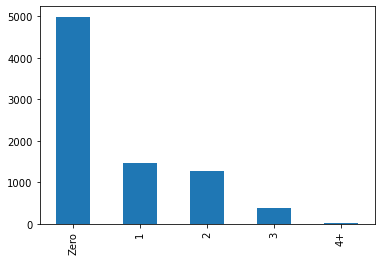

In [17]:
data.children.value_counts().plot(kind = 'bar')

### Checking if we have any duplicate Rows

In [15]:
data[data.duplicated()]

,REF_NO,children,age_band,status,occupation,occupation_partner,home_status,family_income,self_employed,self_employed_partner,...,Investment_Tax_Saving_Bond,Home_Loan,Online_Purchase_Amount,gender,region,Investment_in_Commudity,Investment_in_Equity,Investment_in_Derivative,Portfolio_Balance,Revenue_Grid


### The Age distribution of the customers.


<AxesSubplot:>

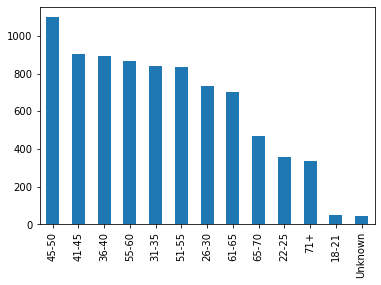

In [18]:
data.age_band.value_counts().plot(kind = 'bar')

### Checking the people marital status

<AxesSubplot:>

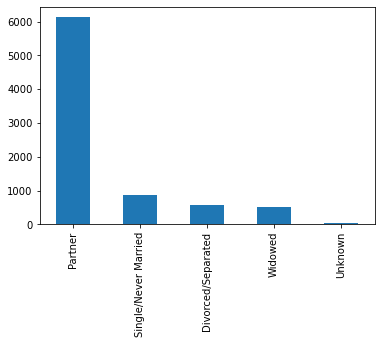

In [20]:
data.status.value_counts().plot(kind = 'bar')

### Checking the maximum loan amount a customer has.

In [21]:
data.Personal_Loan.max()

4905.93

### Checking in which region most of the customers live.

<AxesSubplot:>

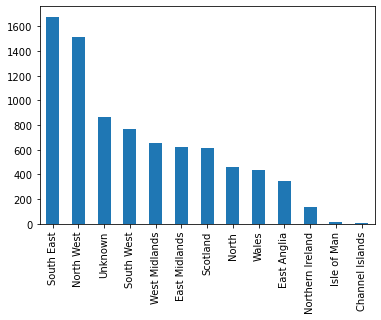

In [22]:
data.region.value_counts().plot(kind='bar')

### Checking the occupation of the most of the customers.

<AxesSubplot:>

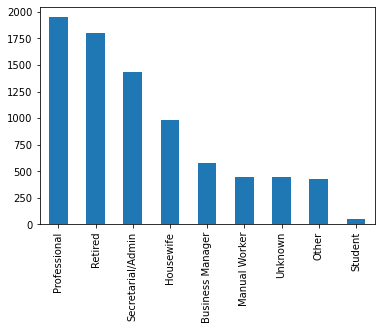

In [23]:
data.occupation.value_counts().plot(kind='bar')

- The maximum of average credict card transaction is an outlier
- Most of the customers are professionals to the bank and the second most customers are retired.
- Most of the customers are living in South east area.
- The maximum of a customer has personal loan of 4905.
- The maximum customers are from 45-50 age group.
- There are no duplicate rows in the data set.

### Checking the Avg account balance of the customers who took home loan.

<AxesSubplot:xlabel='Home_Loan', ylabel='Average_A/C_Balance'>

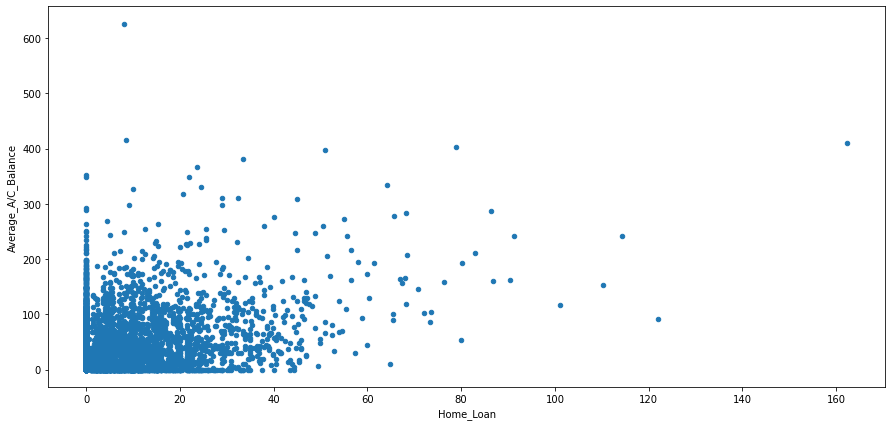

In [25]:
data.plot.scatter(x='Home_Loan', y='Average_A/C_Balance', figsize =(15,7))

### Checking the behaviour of customers who doing online purchase and have portfolio balance

<AxesSubplot:xlabel='Portfolio_Balance', ylabel='Online_Purchase_Amount'>

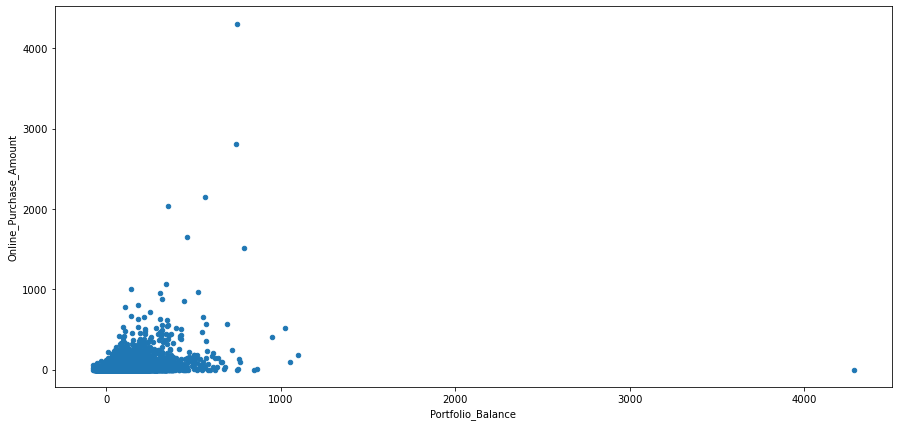

In [29]:
data.plot.scatter(x='Portfolio_Balance', y='Online_Purchase_Amount', figsize =(15,7))

### Checking all the customers term deposit is distributed.

<AxesSubplot:xlabel='Term_Deposit', ylabel='Density'>

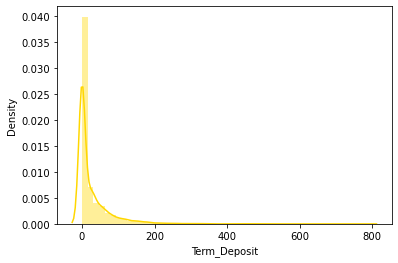

In [33]:
sns.distplot(a= data.Term_Deposit , kde=True, color = 'gold')


### Let's check the correlation between the categories.

<AxesSubplot:>

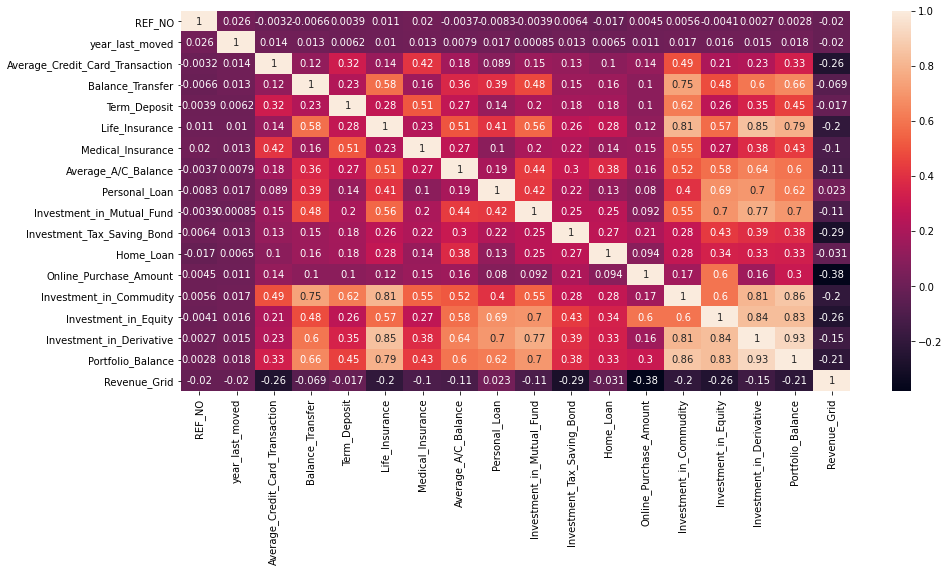

In [38]:
figure = plt.figure(figsize=[15,7])
sns.heatmap(data.corr(), annot = True)

# Observations:

- With the heatmap we can see there are multiple categories have highly correlation. But if we see the target variable(Revenue_Grid), there is no variable has correlated with it.
- Term deposit among the customers are highly right skewd.
- Ignoring the outliers in online purchase and portfolio balance, most of the customers are in the range of 0-600 for both the online purchase and portfolio balance.
- Most of the customers haven't taken the personal loans. 

### Let's do a labeling for all the categorical columns for easy understanding to machine.

In [39]:
from sklearn.preprocessing import LabelEncoder

In [40]:
data.columns

Index(['REF_NO', 'children', 'age_band', 'status', 'occupation',
       'occupation_partner', 'home_status', 'family_income', 'self_employed',
       'self_employed_partner', 'year_last_moved', 'TVarea', 'post_code',
       'post_area', 'Average_Credit_Card_Transaction', 'Balance_Transfer',
       'Term_Deposit', 'Life_Insurance', 'Medical_Insurance',
       'Average_A/C_Balance', 'Personal_Loan', 'Investment_in_Mutual_Fund',
       'Investment_Tax_Saving_Bond', 'Home_Loan', 'Online_Purchase_Amount',
       'gender', 'region', 'Investment_in_Commudity', 'Investment_in_Equity',
       'Investment_in_Derivative', 'Portfolio_Balance', 'Revenue_Grid'],
      dtype='object')

### Bifurcating the categorical and neumarical columns

In [41]:
data_cat = data[['children', 'age_band', 'status', 'occupation',
       'occupation_partner', 'home_status', 'family_income', 'self_employed',
       'self_employed_partner','TVarea', 'post_code',
       'post_area','gender', 'region']]

In [42]:
data_int = data.drop(['children', 'age_band', 'status', 'occupation',
       'occupation_partner', 'home_status', 'family_income', 'self_employed',
       'self_employed_partner','TVarea', 'post_code',
       'post_area','gender', 'region'], axis=1)

### Label encoding to categorical columns

In [43]:
data_cat = data_cat.apply(LabelEncoder().fit_transform)

### Merging the labeled data and neumarical data

In [44]:
data_final = pd.concat([data_cat,data_int], axis=1)

#### To make the "REF_NO" as the first column, tried to made it as a index and done reset index.

In [46]:
data_final.set_index('REF_NO', inplace = True)

In [49]:
data_final.reset_index(inplace=True)

In [50]:
data_final.shape

(8124, 32)

In [51]:
data_final.columns

Index(['REF_NO', 'children', 'age_band', 'status', 'occupation',
       'occupation_partner', 'home_status', 'family_income', 'self_employed',
       'self_employed_partner', 'TVarea', 'post_code', 'post_area', 'gender',
       'region', 'year_last_moved', 'Average_Credit_Card_Transaction',
       'Balance_Transfer', 'Term_Deposit', 'Life_Insurance',
       'Medical_Insurance', 'Average_A/C_Balance', 'Personal_Loan',
       'Investment_in_Mutual_Fund', 'Investment_Tax_Saving_Bond', 'Home_Loan',
       'Online_Purchase_Amount', 'Investment_in_Commudity',
       'Investment_in_Equity', 'Investment_in_Derivative', 'Portfolio_Balance',
       'Revenue_Grid'],
      dtype='object')

In [52]:
data_final.head()

,REF_NO,children,age_band,status,occupation,occupation_partner,home_status,family_income,self_employed,self_employed_partner,...,Personal_Loan,Investment_in_Mutual_Fund,Investment_Tax_Saving_Bond,Home_Loan,Online_Purchase_Amount,Investment_in_Commudity,Investment_in_Equity,Investment_in_Derivative,Portfolio_Balance,Revenue_Grid
0,5466,1,3,1,4,4,1,11,0,0,...,175.43,134.35,8.98,55.44,7.68,151.55,81.79,136.02,360.37,2
1,9091,4,6,1,6,4,1,11,0,0,...,15.99,0.00,0.00,0.00,18.99,44.28,13.91,29.23,89.22,2
2,9744,0,4,1,2,2,2,7,1,1,...,0.02,10.46,0.00,0.00,0.00,8.58,1.75,4.82,14.50,2
3,10700,1,3,1,2,2,1,8,0,0,...,0.00,0.00,0.00,0.00,0.00,15.00,0.00,5.00,68.98,2
4,1987,4,8,1,1,4,1,11,0,0,...,0.00,9.98,0.00,0.00,0.00,0.00,1.66,1.66,1.88,2


### Split the data into x and y. Meaning making the target variable as y.


In [53]:
x = data_final.drop('Revenue_Grid', axis = 1)

In [54]:
y = data_final['Revenue_Grid']

### Import the train test split and split the data into train and test data for x and y.

In [55]:
from sklearn.model_selection import train_test_split

In [56]:
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=1)

### Import the Logistic Regression

In [57]:
from sklearn.linear_model import LogisticRegression

### Instantiate the algo

In [58]:
logreg = LogisticRegression()

In [60]:
x_train.shape

(6499, 31)

In [61]:
y_train.shape

(6499,)

In [63]:
x_test.shape

(1625, 31)

### Train the model using x_train and y_train data

In [64]:
logreg.fit(x_train,y_train)

LogisticRegression()

### Make the predictions using the trained model for test data.

In [65]:
pred = logreg.predict(x_test)

In [66]:
pred

array([2, 2, 2, ..., 2, 2, 2], dtype=int64)

### Let's import the evaluation matrics for this classification model - Logistic Regression

In [67]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import recall_score
from sklearn.metrics import precision_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import f1_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report

In [68]:
accuracy_score(pred,y_test)

0.931076923076923

In [69]:
recall_score(pred,y_test)

0.7730496453900709

In [70]:
precision_score(pred,y_test)

0.5767195767195767

In [72]:
f1_score(y_test,pred)

0.6606060606060606

In [75]:
confusion_matrix(pred,y_test)

array([[ 109,   32],
       [  80, 1404]], dtype=int64)

In [84]:
print(classification_report(y_test,pred))

              precision    recall  f1-score   support

           1       0.77      0.58      0.66       189
           2       0.95      0.98      0.96      1436

    accuracy                           0.93      1625
   macro avg       0.86      0.78      0.81      1625
weighted avg       0.93      0.93      0.93      1625



In [76]:
roc_auc_score(y_test,pred)

0.7772177270784513

# Let's see all the evaluation metrics scores at one place below.

In [129]:
print("The Precision score is: ",precision_score(pred,y_test))
print(" ")
print("The Recall score is: ",recall_score(pred,y_test))
print(" ")
print("The Accuracy score is: ",accuracy_score(pred,y_test))
print(" ")
print("The F1 score is: ",f1_score(y_test,pred))
print(" ")
print("The ROC-AUC score is: ",roc_auc_score(y_test,pred))

The Precision score is:  0.5767195767195767
 
The Recall score is:  0.7730496453900709
 
The Accuracy score is:  0.931076923076923
 
The F1 score is:  0.6606060606060606
 
The ROC-AUC score is:  0.7772177270784513


# Now, let's test how our trained model will work on the data which it never seen. We have a dataset in which we have all the columns except the target column.

In [85]:
test_data = pd.read_csv("existing_base_test.csv")

### Bifurcating the categorical and neumarical columns

In [89]:
test_data_cat = test_data[['children', 'age_band', 'status', 'occupation',
       'occupation_partner', 'home_status', 'family_income', 'self_employed',
       'self_employed_partner','TVarea', 'post_code',
       'post_area','gender', 'region']]

In [92]:
test_data_int = test_data.drop(['children', 'age_band', 'status', 'occupation',
       'occupation_partner', 'home_status', 'family_income', 'self_employed',
       'self_employed_partner','TVarea', 'post_code',
       'post_area','gender', 'region'], axis =1)

### Label encoding the categorical columns

In [93]:
test_data_cat = test_data_cat.apply(LabelEncoder().fit_transform)

### Merging the labeled columns and integer columns

In [94]:
test_data_final = pd.concat([test_data_cat,test_data_int], axis=1)

In [95]:
test_data_final.head()

,children,age_band,status,occupation,occupation_partner,home_status,family_income,self_employed,self_employed_partner,TVarea,...,Average_A/C_Balance,Personal_Loan,Investment_in_Mutual_Fund,Investment_Tax_Saving_Bond,Home_Loan,Online_Purchase_Amount,Investment_in_Commudity,Investment_in_Equity,Investment_in_Derivative,Portfolio_Balance
0,4,11,1,5,1,1,3,0,0,7,...,44.47,0.00,45.97,0.00,0.00,0.00,40.48,15.07,28.40,83.05
1,4,3,1,8,0,1,11,0,0,0,...,29.49,170.31,133.88,27.45,13.47,57.46,27.07,72.01,82.74,235.29
2,4,11,1,1,5,1,4,0,0,6,...,87.83,0.00,107.88,0.00,0.00,0.00,44.39,32.62,43.86,98.38
3,0,1,1,3,3,1,5,0,0,4,...,0.00,102.43,44.96,0.00,0.00,0.00,21.59,24.57,29.23,86.32
4,4,10,4,5,8,1,0,0,0,7,...,32.98,0.00,33.96,6.99,17.93,5.45,53.66,16.22,32.89,102.99


In [97]:
test_data_final.reset_index(inplace=True)

#### To make the "REF_NO" as the first column, tried to made it as a index and done reset index.

In [100]:
test_data_final.set_index('REF_NO', inplace = True)

In [101]:
test_data_final.head()

,index,children,age_band,status,occupation,occupation_partner,home_status,family_income,self_employed,self_employed_partner,...,Average_A/C_Balance,Personal_Loan,Investment_in_Mutual_Fund,Investment_Tax_Saving_Bond,Home_Loan,Online_Purchase_Amount,Investment_in_Commudity,Investment_in_Equity,Investment_in_Derivative,Portfolio_Balance
REF_NO,,,,,,,,,,,,,,,,,,,,,
697,0,4,11,1,5,1,1,3,0,0,...,44.47,0.00,45.97,0.00,0.00,0.00,40.48,15.07,28.40,83.05
7897,1,4,3,1,8,0,1,11,0,0,...,29.49,170.31,133.88,27.45,13.47,57.46,27.07,72.01,82.74,235.29
4729,2,4,11,1,1,5,1,4,0,0,...,87.83,0.00,107.88,0.00,0.00,0.00,44.39,32.62,43.86,98.38
6914,3,0,1,1,3,3,1,5,0,0,...,0.00,102.43,44.96,0.00,0.00,0.00,21.59,24.57,29.23,86.32
2795,4,4,10,4,5,8,1,0,0,0,...,32.98,0.00,33.96,6.99,17.93,5.45,53.66,16.22,32.89,102.99


In [103]:
test_data_final.drop('index',axis=1, inplace = True)

In [105]:
test_data_final.reset_index(inplace = True)

In [111]:
test_data_final.set_index('REF_NO', inplace = True)

In [113]:
test_data_final.reset_index(inplace=True)

# Predicting the Revenue_Grid for all the rows are available in the test data.

In [114]:
test_data_pred = logreg.predict(test_data_final)

In [115]:
test_data_pred

array([2, 2, 2, ..., 2, 1, 2], dtype=int64)

In [116]:
test_data_pred = pd.DataFrame(test_data_pred)

In [117]:
test_data_pred

,0
0,2
1,2
2,2
3,2
4,2
...,...
2026,2
2027,2
2028,2
2029,1


## Making the submission file which should have only two columns that are key column(REF_NO) and target column(Revenue_Grid)

In [118]:
submission_file = pd.concat([test_data_final,test_data_pred], axis = 1)

In [119]:
submission_file = submission_file[['REF_NO',0]]

In [120]:
submission_file.head()

,REF_NO,0
0,697,2
1,7897,2
2,4729,2
3,6914,2
4,2795,2


### Saving the file into our local system

In [122]:
submission_file.to_csv("Customer_Classification_Submission_File.csv", index=False, header=False)